# Deep Convolutional GAN with PyTorch

Implementation of the DCGAN architecture from scrath with PyTorch and training it on the [frog dataset](https://github.com/jonshamir/frog-dataset).

DCGAN is a very basic GAN architecture for image generation. It has two parts: a **generator** that learns a mapping from n-dimensional Gaussian noise to the actual images, and built with ConvTransposed2d-BatchNorm-LeakyReLU blocks with Tanh activation on the last and the **discriminator** that learns to classify real and generated images, which consists of blocks Conv2d-BatchNorm-ReLU. Because of predicting probabilities, the binary cross-entropy loss is used to backpropagate in both of generator and discriminator training step.

Parameters of the models architecture and the optimizers are the same as in the original article, unless otherwise noted.

References:
- [Original DCGAN paper](https://arxiv.org/pdf/1511.06434.pdf)
- [PyTorch DCGAN tutorial](https://pytorch.org/tutorials/beginner/dcgan_faces_tutorial.html)
- [deeplearing.ai course](https://www.coursera.org/learn/build-basic-generative-adversarial-networks-gans/home/week/2)

In [1]:
# mount gdrive to save models
from pathlib import Path
from google.colab import drive

drive.mount('/content/gdrive')

GDRIVE = '/content/gdrive/MyDrive/neurofrogs'
WORKDIR = GDRIVE + '/dcgan/'
Path(WORKDIR).mkdir(parents=True, exist_ok=True)

Mounted at /content/gdrive


In [2]:
# install the IS and the FID metrics
%%capture
%pip install pytorch-fid-wrapper
!curl https://raw.githubusercontent.com/sbarratt/inception-score-pytorch/master/inception_score.py >inception_score.py

In [3]:
import torch
from torch import nn
from torchvision import transforms
from torchvision.utils import make_grid
from torch.utils.data import DataLoader
from PIL import Image
from IPython.display import clear_output
from tqdm.auto import tqdm
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
sns.set_style('whitegrid')
plt.rcParams['axes.labelsize'] = 14
plt.rcParams['legend.fontsize'] = 14
plt.rcParams['legend.facecolor'] = 'seashell'
import os
import glob
import pickle
import time
from inception_score import inception_score
import pytorch_fid_wrapper as pfw

import warnings
warnings.simplefilter("ignore")

device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
pfw.set_config(device=device)

gpu = None
if device!='cpu':
    gpu = !nvidia-smi --query-gpu=gpu_name  --format=csv,noheader
print(f'Device: {device}\n'
      f'GPU: {gpu}\n'
      f'PyTorch version: {torch.__version__}')

Device: cuda:0
GPU: ['Tesla T4']
PyTorch version: 1.9.0+cu102


In [4]:
# Visualization

def show_tensor_images(image_tensor, num_images=25, ax=None):
    '''
    Function for visualizing images: Given a tensor of images, number of images, and
    size per image, plots and prints the images in an uniform grid.
    '''
    image_tensor = (image_tensor + 1) / 2
    image_tensor = image_tensor.detach().cpu()
    if num_images > 1:
      image_tensor = make_grid(image_tensor[:num_images], nrow=int(num_images**0.5), padding=1)
    image_tensor = image_tensor.permute(1, 2, 0).squeeze()
    if ax is None:
        ax = plt
    ax.imshow(image_tensor)
    ax.axis('off')

# Data Loading

In [5]:
# load the frog dataset
!git clone https://github.com/jonshamir/frog-dataset.git /content/data

Cloning into '/content/data'...
remote: Enumerating objects: 53349, done.
remote: Total 53349 (delta 0), reused 0 (delta 0), pack-reused 53349
Receiving objects: 100% (53349/53349), 1.02 GiB | 45.95 MiB/s, done.
Resolving deltas: 100% (113/113), done.
Checking out files: 100% (23392/23392), done.


In [6]:
class UnlabeledDataset(torch.utils.data.Dataset):
    def __init__(self, path, transform=None):
        self.image_paths = glob.glob(path + '*.png')
        self.transform = transform

    def __getitem__(self, index):
        x = Image.open(self.image_paths[index])
        # remove alpha channel
        background = Image.new('RGBA', x.size, (255,255,255))
        x = Image.alpha_composite(background, x)
        x = x.convert('RGB')
        if self.transform is not None:
            x = self.transform(x)
        return x

    def __len__(self):
        return len(self.image_paths)

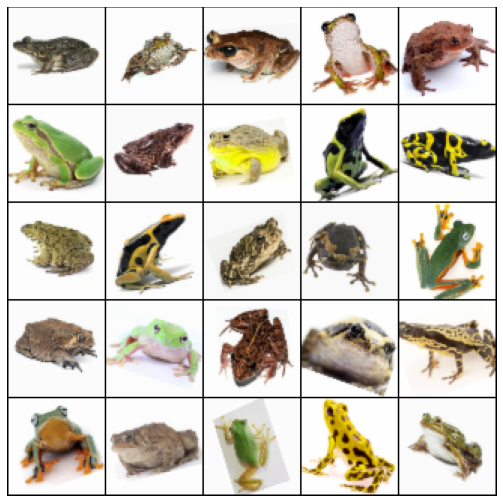

In [7]:
TRAIN_DATA_PATH = '/content/data/data-224/'
BATCH_SIZE = 256


TRANSFORM_IMG = transforms.Compose([
    transforms.RandomHorizontalFlip(),
    transforms.RandomPerspective(distortion_scale=0.30, p=0.5, fill=(255,255,255)),
    transforms.RandomRotation(20, fill=(255,255,255)),
    transforms.ColorJitter(brightness=0., contrast=0.1, saturation=0.3, hue=0.05),

    transforms.ToTensor(),
    transforms.Resize((64, 64)),
    transforms.GaussianBlur(kernel_size=(3, 3), sigma=0.45),
    transforms.Normalize([0.5], [0.5]),
    ])

train_data = UnlabeledDataset(path=TRAIN_DATA_PATH, transform=TRANSFORM_IMG)
train_loader = DataLoader(dataset=train_data,
                          batch_size=BATCH_SIZE,
                          shuffle=True,
                          num_workers=2
                          )

plt.subplots(figsize=(9, 9))
i = next(iter(train_loader))
show_tensor_images(i[0:25]);

# Utils

In [8]:
# Checkpoints

def create_checkpoint(model=None,
                      optimizer=None,
                      epoch=0,
                      filename=None,
                      directory=WORKDIR,
                      **kwargs):
    if filename is None:
        if model: 
            classname = model.__class__.__name__
        else:
            classname = 'Additional'
        filename = f'{classname}-{epoch}.pt'
    filename = directory + filename

    checkpoint = dict()
    if model:
        checkpoint['model'] = model.state_dict()
    if optimizer:
        checkpoint['optimizer'] = optimizer.state_dict()
    if epoch != 0:
        checkpoint['epoch'] = epoch
    checkpoint.update(kwargs)
    torch.save(checkpoint, filename)
    return filename


def load_checkpoint(path, model_class, train=True, **kwargs):
    checkpoint = torch.load(path)
    model = model_class(**kwargs).to(device)
    model.load_state_dict(checkpoint['model'])
    if not train:
        model.eval()
        return model
    model_optimizer = torch.optim.Adam(model.parameters())
    model_optimizer.load_state_dict(checkpoint['optimizer'])
    model.train()
    return model, model_optimizer

In [9]:
# Evaluation

def get_is_fid(generator, num_fake=len(train_data)):
    noise = torch.randn(num_fake, generator.z_dim, device=device)
    generator.eval()
    fake_images = generator(noise)
    generator.train()
    iss = inception_score(fake_images, batch_size=32, resize=True, splits=10)
    fid = pfw.fid(fake_images, real_m=REAL_M, real_s=REAL_S)
    del fake_images, noise
    torch.cuda.empty_cache()
    return iss, fid

# Load or compute inception statistics of the train dataset
filename = WORKDIR+'../dataset_inception_statistics.npz'

if os.path.isfile(filename):
    npz = np.load(filename)
    REAL_M = npz['REAL_M']
    REAL_S = npz['REAL_S']
else:
    transform = transforms.Compose([
      transforms.ToTensor(),
      transforms.Normalize([0.5], [0.5]),
    ])
    _data = UnlabeledDataset(path='/content/data/data-64/', transform=transform)
    _loader = DataLoader(dataset=_data)
    real_data = torch.vstack([i for i in _loader])
    REAL_M, REAL_S = pfw.get_stats(real_data)
    np.savez(WORKDIR+'../dataset_inception_statistics.npz', REAL_M=REAL_M, REAL_S=REAL_S)
    del real_data
    torch.cuda.empty_cache()

# Model definition

In [10]:
class Discriminator(nn.Module):
    def __init__(self, im_chan=3, hidden_dim=64):
        super(Discriminator, self).__init__()
        self.disc = nn.Sequential(
            # input is (im_chan) x 64 x 64
            nn.Conv2d(im_chan, hidden_dim, kernel_size=4,
                      stride=2, padding=1, bias=False),
            nn.LeakyReLU(0.2, inplace=True),

            # state size. (hidden_dim) x 32 x 32
            nn.Conv2d(hidden_dim, hidden_dim * 2, kernel_size=4,
                      stride=2, padding=1, bias=False),
            nn.BatchNorm2d(hidden_dim * 2),
            nn.LeakyReLU(0.2, inplace=True),

            # state size. (hidden_dim*2) x 16 x 16
            nn.Conv2d(hidden_dim * 2, hidden_dim * 4, kernel_size=4,
                      stride=2, padding=1, bias=False),
            nn.BatchNorm2d(hidden_dim * 4),
            nn.LeakyReLU(0.2, inplace=True),

            # state size. (hidden_dim*4) x 8 x 8
            nn.Conv2d(hidden_dim * 4, hidden_dim * 8, kernel_size=4,
                      stride=2, padding=1, bias=False),
            nn.BatchNorm2d(hidden_dim * 8),
            nn.LeakyReLU(0.2, inplace=True),

            # state size. (hidden_dim*8) x 4 x 4
            nn.Conv2d(hidden_dim * 8, 1, kernel_size=4,
                      stride=1, padding=0, bias=False)
            # Linear output! 
        )

    def forward(self, input):
        return self.disc(input)

In [11]:
class Generator(nn.Module):

    def __init__(self, z_dim=100, im_chan=3, hidden_dim=64):
        super(Generator, self).__init__()
        self.z_dim = z_dim
        self.gen = nn.Sequential(
            # input is Z, going into a convolution
            nn.ConvTranspose2d( z_dim, hidden_dim * 8, kernel_size=4,
                               stride=1, padding=0, bias=False),
            nn.BatchNorm2d(hidden_dim * 8),
            nn.ReLU(True),

            # state size. (hidden_dim*8) x 4 x 4
            nn.ConvTranspose2d(hidden_dim * 8, hidden_dim * 4, kernel_size=4,
                               stride=2, padding=1, bias=False),
            nn.BatchNorm2d(hidden_dim * 4),
            nn.ReLU(True),

            # state size. (hidden_dim*4) x 8 x 8
            nn.ConvTranspose2d(hidden_dim * 4, hidden_dim * 2, kernel_size=4,
                               stride=2, padding=1, bias=False),
            nn.BatchNorm2d(hidden_dim * 2),
            nn.ReLU(True),

            # state size. (hidden_dim*2) x 16 x 16
            nn.ConvTranspose2d(hidden_dim * 2, hidden_dim, kernel_size=4,
                               stride=2, padding=1, bias=False),
            nn.BatchNorm2d(hidden_dim),
            nn.ReLU(True),

            # state size. (hidden_dim) x 32 x 32
            nn.ConvTranspose2d(hidden_dim, im_chan, kernel_size=4,
                               stride=2, padding=1, bias=False),
            nn.Tanh()
            # state size. (im_chan) x 64 x 64
        )

    def unsqueeze_noise(self, noise):
        return noise.view(len(noise), self.z_dim, 1, 1)

    def forward(self, noise):
        x = self.unsqueeze_noise(noise)
        return self.gen(x)

In [12]:
def weights_init(m):
    classname = m.__class__.__name__
    if classname.find('Conv') != -1:
        nn.init.normal_(m.weight.data, 0.0, 0.02)
    elif classname.find('BatchNorm') != -1:
        nn.init.normal_(m.weight.data, 1.0, 0.02)
        nn.init.constant_(m.bias.data, 0)

# GAN training


## Parameters

In [13]:
NDF = 64
NGF = 64
Z_DIM = 100

criterion = nn.BCEWithLogitsLoss()

lr = 0.0002
beta_1 = 0.5 
beta_2 = 0.999

np.random.seed(0)
fixed_noise = torch.Tensor(np.random.randn(16, Z_DIM)).to(device)

REAL_LABEL = 1.
FAKE_LABEL = 0.

## Training loop

In [14]:
RESTORE = 1200

if RESTORE is None or RESTORE == 0:
    discriminator = Discriminator(hidden_dim=NDF).to(device)
    discriminator_optimizer = torch.optim.Adam(discriminator.parameters(), lr=lr, betas=(beta_1, beta_2))
    generator = Generator(hidden_dim=NGF, z_dim=Z_DIM).to(device)
    generator_optimizer = torch.optim.Adam(generator.parameters(), lr=lr, betas=(beta_1, beta_2))
    discriminator.apply(weights_init)
    generator.apply(weights_init)
    G_losses, D_losses = [], []
    times = []
    is_scores, fid_scores = [], []
    viz_progress = []
    initial_epoch = 0
else:
    generator, generator_optimizer = load_checkpoint(WORKDIR+f'Generator-{RESTORE}.pt', Generator, hidden_dim=NGF, z_dim=Z_DIM)
    discriminator, discriminator_optimizer = load_checkpoint(WORKDIR+f'Discriminator-{RESTORE}.pt', Discriminator, hidden_dim=NDF)
    checkpoint = torch.load(WORKDIR+f'Statistics.pt')
    if checkpoint['epoch'] != RESTORE:
        print('WARNING! Epoch in statistics file does not match epoch in RESTORE')
    G_losses = checkpoint['G_losses']
    D_losses = checkpoint['D_losses']
    times = checkpoint['times']
    is_scores = checkpoint['is_scores']
    fid_scores = checkpoint['fid_scores']
    viz_progress = checkpoint['viz_progress']

    initial_epoch = RESTORE
    print(f'Restored from {RESTORE} epoch checkpoint')

Restored from 1200 epoch checkpoint


In [15]:
# Training Loop
NUM_EPOCHS = 1200
DISPLAY_STEP = 10
EVAL_STEP = 10
CHECKPOINT_STEP = 100

In [16]:
print("Starting Training Loop...")
# For each epoch
for epoch in range(initial_epoch+1, NUM_EPOCHS+1):
    print(f'Epoch: {epoch}')
    start = time.time()
    for i, data in enumerate(tqdm(train_loader)):
        # (1) Update discriminator
        discriminator.zero_grad()

        ## Train with all-real batch
        real = data.to(device)
        batch_size = real.size(0)

        output = discriminator(real)
        label = torch.full_like(output, REAL_LABEL)
        discriminator_real_loss = criterion(output, label)
        
        ## Train with all-fake batch
        noise = torch.randn(batch_size, Z_DIM, device=device)
        fake = generator(noise).detach()
        output = discriminator(fake)
        label = torch.full_like(output, FAKE_LABEL)
        discriminator_fake_loss = criterion(output, label)

        discriminator_loss = (discriminator_real_loss + discriminator_fake_loss) / 2
        discriminator_loss.backward()
        discriminator_optimizer.step()

        # (2) Update generator
        generator.zero_grad()
        fake = generator(noise)
        output = discriminator(fake)
        label = torch.full_like(output, REAL_LABEL)
        generator_loss = criterion(output, label)
        generator_loss.backward()
        generator_optimizer.step()

        # Save Losses for plotting later
        G_losses.append(generator_loss.item())
        D_losses.append(discriminator_loss.item())
        
    print(f'real_loss {discriminator_real_loss.item()}\t fake_loss {discriminator_fake_loss.item()}')
    print(f'Loss_D: {D_losses[-1]:.4f}\tLoss_G: {G_losses[-1]:.4f}')
    times.append(time.time() - start)
    
    if epoch % EVAL_STEP == 0:
        score = get_is_fid(generator)
        is_scores.append(score[0])
        fid_scores.append(score[1])
        viz_progress.append(generator(fixed_noise).detach().cpu())
        print(f'Evaluation results: {score}')

    if epoch % DISPLAY_STEP == 0:
        fake = generator(fixed_noise).detach().cpu()
        show_tensor_images(fake, fake.shape[0])
        plt.show()

    if (epoch % CHECKPOINT_STEP == 0 and epoch > 0) or epoch == NUM_EPOCHS:
        create_checkpoint(generator, generator_optimizer, epoch)
        create_checkpoint(discriminator, discriminator_optimizer, epoch)
        create_checkpoint(G_losses=G_losses, D_losses=D_losses, times=times,
                          epoch=epoch, is_scores=is_scores, fid_scores=fid_scores,
                          viz_progress=viz_progress,
                          filename='Statistics.pt')
        clear_output()
        print("Saved!")


Saved!


# Results

In [17]:
# Load training statistics
checkpoint = torch.load(WORKDIR+f'Statistics.pt')
G_losses = checkpoint['G_losses']
D_losses = checkpoint['D_losses']
times = checkpoint['times']
is_scores = checkpoint['is_scores']
fid_scores = checkpoint['fid_scores']
viz_progress = checkpoint['viz_progress']
eval_epochs = np.arange(10, NUM_EPOCHS+1, EVAL_STEP)

### Training statistics

In [18]:
f'{np.mean(times):0.5f} seconds per epoch'

'56.07825 seconds per epoch'

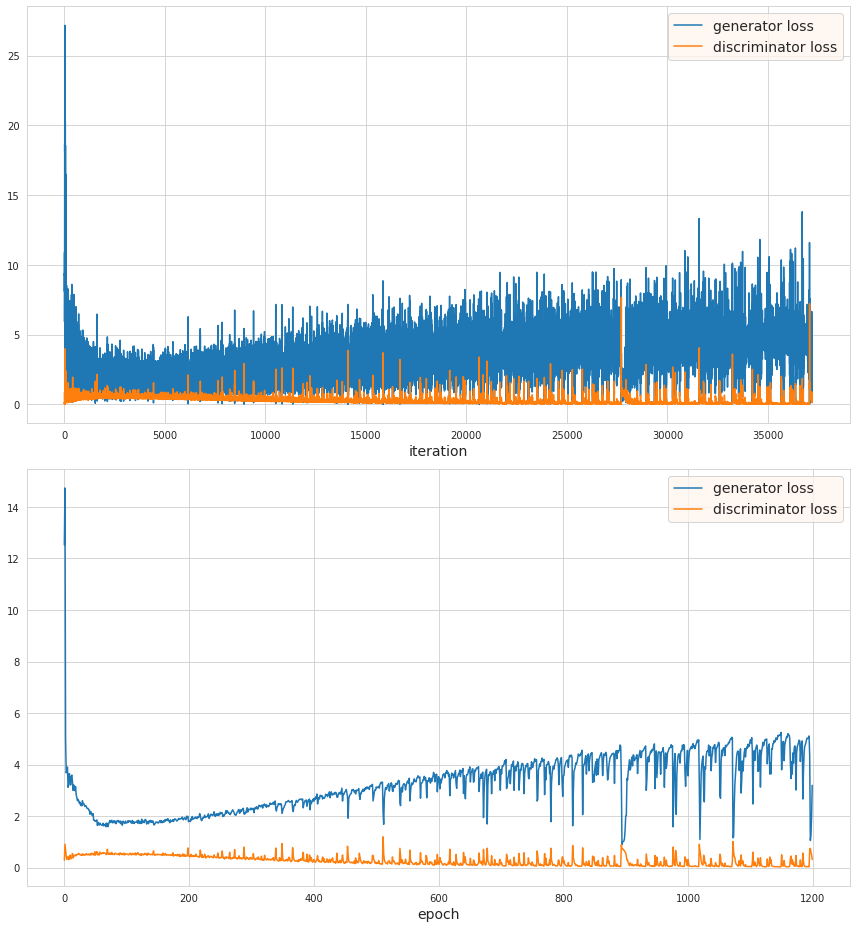

In [19]:
D_epoch_losses = np.array(D_losses).reshape(-1, 31).mean(axis=1)
G_epoch_losses = np.array(G_losses).reshape(-1, 31).mean(axis=1)

_, (ax1, ax2) = plt.subplots(2, 1, figsize=(12, 13), tight_layout=True)
ax1.plot(G_losses, label='generator loss')
ax1.plot(D_losses, label='discriminator loss')
ax1.set_xlabel('iteration')
ax1.legend();

ax2.plot(G_epoch_losses, label='generator loss')
ax2.plot(D_epoch_losses, label='discriminator loss')
ax2.set_xlabel('epoch')
ax2.legend();

We can see that discriminator fastly starts to overcome the generator. While discriminator loss starts to take small, close to zero values, generator loss still grows, which means that the discriminator stops give to generator a meaningful feedback.

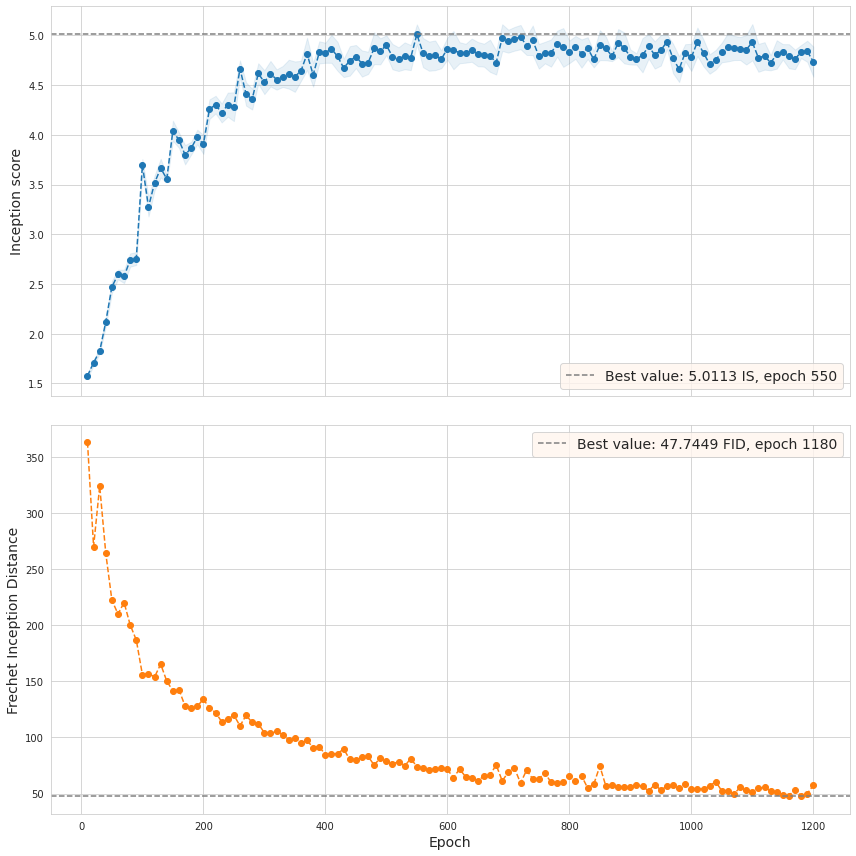

In [20]:
iss = np.array(is_scores)
iss, iss_std = iss[:, 0], iss[:, 1]
fig, (ax1, ax2) = plt.subplots(2, 1, figsize=(12, 12), tight_layout=True, sharex=True)
ax1.plot(eval_epochs, iss, 'o--');
ax1.fill_between(eval_epochs, (iss-iss_std), (iss+iss_std), color='tab:blue', alpha=.1)
ax1.axhline(np.max(iss), linestyle='--', color='tab:gray',
            label=f"Best value: {np.max(iss):.4f} IS, epoch {eval_epochs[np.argmax(iss)]}")
ax1.legend()
ax1.set_ylabel("Inception score")
ax1.set_xlabel(' ')

ax2.plot(eval_epochs, fid_scores, 'o--', color='tab:orange')
ax2.axhline(np.min(fid_scores), linestyle='--', color='tab:gray',
            label=f"Best value: {np.min(fid_scores):.4f} FID, epoch {eval_epochs[np.argmin(fid_scores)]}")
ax2.legend()
ax2.set_ylabel("Frechet Inception Distance")
ax2.set_xlabel("Epoch");

Scores were not really stable (also there was an impact of the stochastic nature of scoring).

## Generated images

### Training animation

In [21]:
%%capture
%pip install celluloid
from celluloid import Camera
from IPython.display import HTML

Animation size has reached 21004513 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


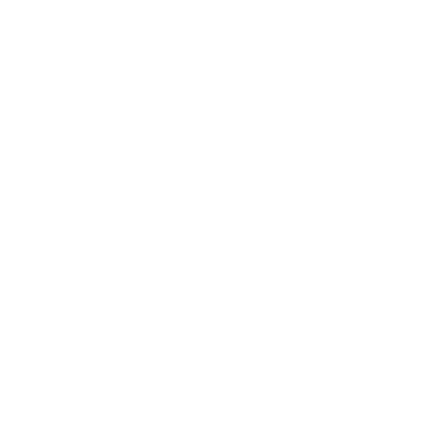

In [22]:
fig, ax1 = plt.subplots(figsize=(6, 6), tight_layout=True)
camera = Camera(fig)

for i, image_tensor in enumerate(viz_progress):
    show_tensor_images(image_tensor, num_images=16, ax=ax1)
    ax1.text(0.5, 1.01, f'Epoch {eval_epochs[i]}', transform=ax1.transAxes, fontsize=14, ha='center')
    camera.snap()
animation = camera.animate()
animation.save(WORKDIR+'training_progress.gif', writer='pillow')
HTML(animation.to_jshtml())

### Visual exploration

In [23]:
epoch_checkpoints = np.arange(200, NUM_EPOCHS+1, 200)
load_gen = lambda x: load_checkpoint(WORKDIR+f'Generator-{x}.pt', Generator, train=False, hidden_dim=NGF, z_dim=Z_DIM)

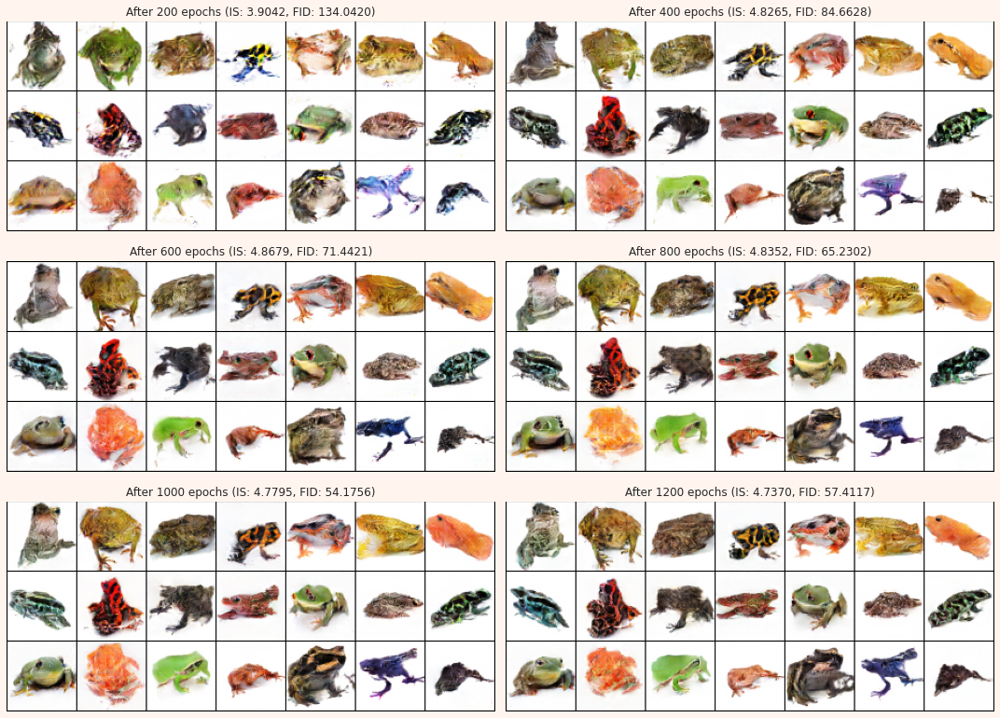

In [24]:
num_gens = len(epoch_checkpoints)
rows = (num_gens + 1)//2
fig, axs = plt.subplots(rows, 2, figsize=(15, 10/3*rows + 1), facecolor='seashell', tight_layout=True)
axs = axs.ravel()

noise = torch.randn(21, Z_DIM, device=device)

for i, epoch in enumerate(epoch_checkpoints):
    score_idx = (np.abs(eval_epochs - epoch)).argmin()
    
    gen = load_gen(epoch)
    image_tensor = gen(noise)
    show_tensor_images(image_tensor, num_images=49, ax=axs[i])
    axs[i].set_title(f'After {epoch} epochs (IS: {iss[score_idx]:.4f}, FID: {fid_scores[score_idx]:.4f})')

The generated images don't look very good.

The images produced by epoch 1000 and 1200 checkpoints are of the highest quality, which correlates with the FID and IS scores.

On epoch 200, GAN weights had not converged close enough to optimum yet, generated images have a recognizable contour, but poor detalization and in-motion-like distortions.

All the rest look similar, but epoch 1000 and 1200 are more detalized and have less "in-motion" blur.

### Interpolation

In [25]:
def slerp(low, high, val):
    low_norm = low / torch.norm(low, dim=1, keepdim=True)
    high_norm = high / torch.norm(high, dim=1, keepdim=True)
    omega = torch.acos((low_norm * high_norm).sum(1))
    so = torch.sin(omega)
    res = (torch.sin((1.0-val)*omega)/so).unsqueeze(1)*low + (torch.sin(val*omega)/so).unsqueeze(1) * high
    return res

In [26]:
generator1000 = load_gen(1000)
generator1200 = load_gen(1200)

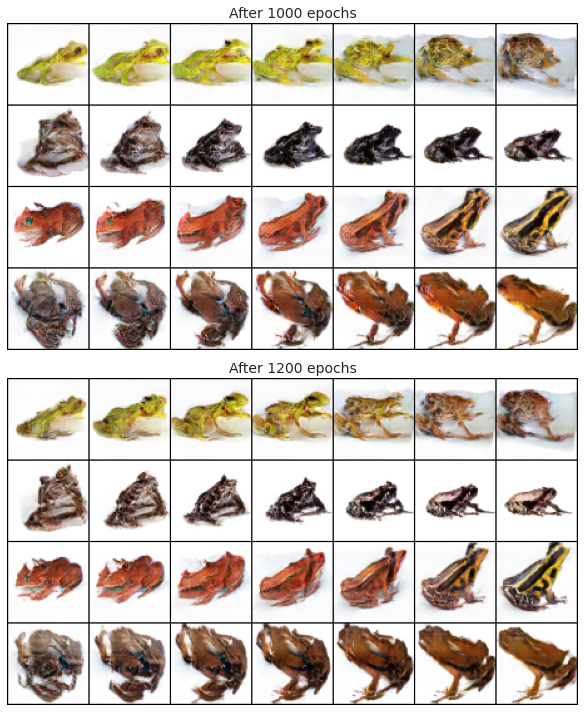

In [27]:
frog1 = torch.randn(4, Z_DIM, device=device)
frog2 = torch.randn(4, Z_DIM, device=device)

T = torch.vstack([slerp(frog1, frog2, a) for a in np.linspace(0,1,7)])
image_tensor_1000 = (generator1000(T).reshape(7, 4, 3, 64, 64)
                                   .permute(1,0,2,3,4)
                                   .reshape(28, 3, 64, 64)
                                   )
image_tensor_1200 = (generator1200(T).reshape(7, 4, 3, 64, 64)
                                   .permute(1,0,2,3,4)
                                   .reshape(28, 3, 64, 64)
                                   )

fig, axs = plt.subplots(2, 1, figsize=(12, 10), tight_layout=True)
show_tensor_images(image_tensor_1000, num_images=49, ax=axs[0])
axs[0].set_title("After 1000 epochs", fontsize=14)
show_tensor_images(image_tensor_1200, num_images=49, ax=axs[1])
axs[1].set_title("After 1200 epochs", fontsize=14);

## Discriminator insights

In [28]:
discriminator1000 = load_checkpoint(WORKDIR+'Discriminator-1000.pt',
                                    Discriminator, hidden_dim=NDF, train=False)

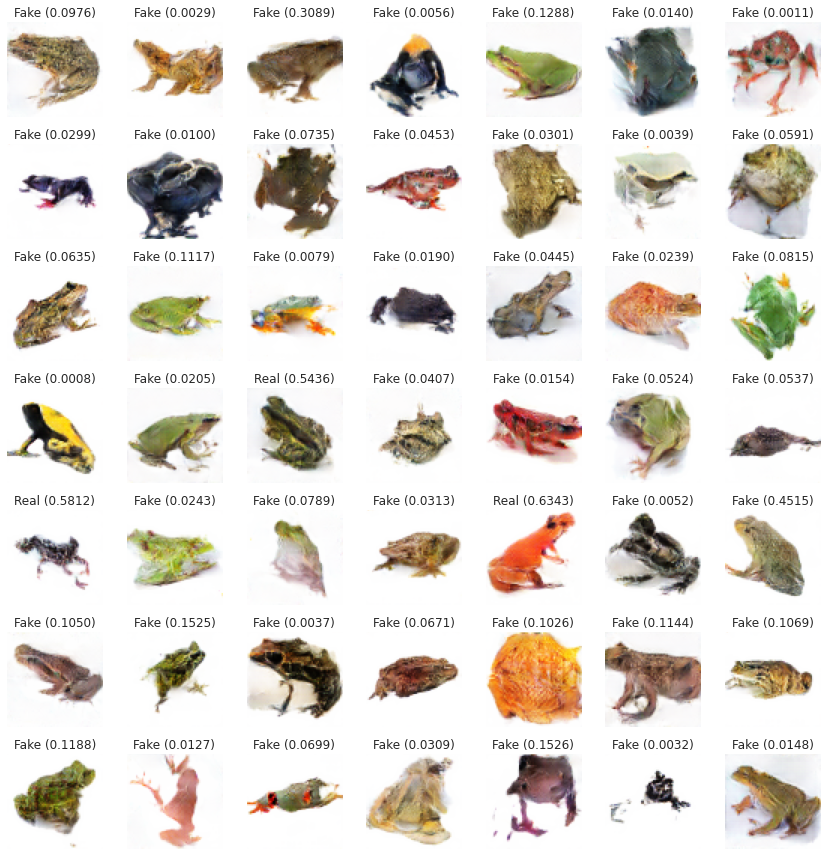

In [29]:
noise = torch.randn(49, Z_DIM, device=device)

fake_images = generator1000(noise)
probs = torch.sigmoid(discriminator1000(fake_images))
probs = probs.detach().cpu().numpy().ravel()

fig, axs = plt.subplots(7, 7, figsize=(12, 12), tight_layout=True)
axs = axs.ravel()

for i, image in enumerate(fake_images):
    pred = "Fake" if probs[i] < 0.5 else "Real"
    axs[i].set_title(f'{pred} ({probs[i]:.4f})')
    show_tensor_images(image,1, axs[i])

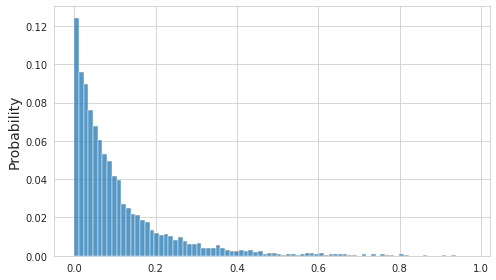

In [30]:
noise = torch.randn(7000, Z_DIM, device=device)
fake_images = generator1000(noise)
probs = torch.sigmoid(discriminator1000(fake_images))
probs = probs.detach().cpu().numpy().ravel()
del fake_images, noise
torch.cuda.empty_cache()

fig, ax = plt.subplots(figsize=(7, 4), tight_layout=True)
sns.histplot(probs, stat='probability');

Discriminator's output for generated images already highly shifted to zero at epoch 1000.

# Summary
Produced images aren't of good quality and their FID is high.
Knowing that this generator architecture can produce great looking images (as in original paper), we can suggest that the main problem of such simple GAN is discriminator overfitting. While reducing of discriminator's capacity produces worse images (observed in previous experiments), maybe we should apply other regularization techniques or architectures, to improve results.